<a href="https://colab.research.google.com/github/peguescj/data-management/blob/main/PS4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

aok: have sections like this

# big sec
## smaller sec


In [1]:
#aok: typo in file name: should be ".ipynb" not "ipynb"--forgot dot "."

In [2]:
!pip install ydata-profiling
from ydata_profiling import ProfileReport

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.5/357.5 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.8/395.8 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 9.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 39.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 31.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 49.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 46.8 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=4a6904d4666d36f058e2b35b39347d9712f485afd5006968c68381d8c71d88e0
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.5.0
  

In [3]:
#---------------------------SETUP----------------------------------
#get useful libraries
import time, os, sys, re #basics
import zipfile, json, datetime, string   #string for annotating points in scatter
import numpy as np #basic math
from statistics import * #stats

import matplotlib.pyplot as plt #import pylab as plt #apparently discouraged now:
 #https://stackoverflow.com/questions/11469336/what-is-the-difference-between-pylab-and-pyplot
 #https://www.tutorialspoint.com/matplotlib/matplotlib_pylab_module.htm

import pandas as pd
import pandas_datareader as pdr
from pandas_datareader import wb
from pandas.io.formats.style import Styler
#s4 = Styler(df4, uuid_len=0, cell_ids=False)

import urllib  #weird, guess need to have os and pandas imported for this to work  %TODO/LATER ditch it, its weird anyway, just use wget/curl

from google.colab import files

#import webbrowser

import seaborn as sns

from google.colab import data_table
data_table.enable_dataframe_formatter() #this enables spreadsheet view upon calling dataframe (without() )

#many tricks how to extend notebook functionality
#https://coderzcolumn.com/tutorials/python/list-of-useful-magic-commands-in-jupyter-notebook-lab
#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

#MAGICS and THEMES/STYLES: important! does affect not just shading/colors, but also fonts, spacing, etc
#(even if you only select default (v not selecting anything) [but does seem to work better if you do make explicit sleections])

###magics: https://ipython.readthedocs.io/en/stable/interactive/magics.html
#most essential setup for vis: it does affect vis! careful!! stick with inline, maybe notebook; others mostly for non-notebook, eg spyder environ
#https://jakevdp.github.io/PythonDataScienceHandbook/04.00-introduction-to-matplotlib.html recomends *inline*!
#show current one:
#%matplotlib
#%matplotlib --list
#interactive plots:
#%matplotlib notebook
#static images of your plot:
%matplotlib inline
#may play with this one and other magics (btw default is probably agg)
#%matplotlib nbagg

###themes/styles: https://matplotlib.org/stable/gallery/style_sheets/style_sheets_reference.html
#https://jakevdp.github.io/PythonDataScienceHandbook/04.11-settings-and-stylesheets.html
#https://matplotlib.org/stable/tutorials/introductory/customizing.html
#here more about art and style than under the hood functionality as with magics, explore and experiment
#many may find 'default' or seaborn ones more pleasing; my fav 'classic' is back from 90s ;)
#plt.style.available #list available styles :) may install more
#plt.style.use('default') # more delicate subtle than classic
plt.style.use('classic')  #  'seaborn-whitegrid' 'seaborn-white' 'seaborn-poster'
# btw: magics v theme/style sequence matters, eg if i specify classic style before inline magic, i wouldnt get grey bounding box im getting

PS2 Submission
Data Sources and explainations within this linked doc
https://docs.google.com/document/d/1UtEePRrVqUHWjPAYSCcnqK9rabKoOY9U-yETtrxUfuk/edit?usp=sharing
aok: need to make it public first

In [4]:
#Uploading the NJ Per Pupil Expenditure Data as a CSV.
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1HCCdqd0pEMFDnBSAjlQ-AULTGKQpbM1P&export=download", "PerPupil.csv")
!wget -q -O PerPupil.csv https://docs.google.com/uc?id=1HCCdqd0pEMFDnBSAjlQ-AULTGKQpbM1P&export=download

In [5]:
# basic navigation
#wd =  'PerPupil'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
PerPupil.csv  sample_data


In [6]:
dat=pd.read_csv('PerPupil.csv') #read it in  ; or full path: '/content/final_data.csv'

In [7]:
dat.columns #list var names

Index(['county_id', 'coname', 'district_id', 'distname', 'line_desc', 'year1',
       'year2', 'year3', 'year4', 'year5'],
      dtype='object')

In [8]:
dat["year1"][0:50] #How much the school spent money in 2016
#aok yea good to have a look, but could be more meaningful if list along with some meaningful name like school name etc

0     $11,318 
1      $7,550 
2      $7,202 
3        $264 
4         $84 
5      $1,277 
6      $1,103 
7      $1,262 
8      $1,062 
9      $1,164 
10       $635 
11         $0 
12        $55 
13         $0 
14        $20 
15      30.63%
16    $19,422 
17    $12,021 
18    $11,376 
19       $424 
20       $220 
21     $2,864 
22     $2,605 
23     $1,602 
24     $1,290 
25     $2,644 
26     $1,477 
27         $0 
28       $235 
29        $32 
30       $111 
31      33.45%
32    $11,998 
33     $6,343 
34     $5,909 
35       $382 
36        $52 
37     $1,397 
38     $1,299 
39     $1,197 
40       $863 
41     $2,533 
42     $1,292 
43         $0 
44       $292 
45       $161 
46        $22 
47      33.44%
48    $49,255 
49    $28,329 
Name: year1, dtype: object

In [9]:
#Looking to see if the total cost is static over years
#Seems like previous years spending is a good indicator of next years - Is there a built in way to regress in python?
#aok: yes:
#https://github.com/theaok/vis/blob/main/ols.ipynb
dat[["year1","year2", "year3"]][0:50] #aok: good;
#can also subset at the very begiing after loading
#the data to make things easier from the begining

,year1,year2,year3
0,"$11,318","$11,148","$11,731"
1,"$7,550","$7,465","$7,937"
2,"$7,202","$7,218","$7,693"
3,$264,$192,$158
4,$84,$56,$86
5,"$1,277","$1,235","$1,201"
6,"$1,103","$1,045","$1,004"
7,"$1,262","$1,276","$1,345"
8,"$1,062","$1,083","$1,093"
9,"$1,164","$1,117","$1,184"


In [143]:
#Scatter plot to visualize the above a bit better
#dat.plot(kind='scatter', y='year1', x='year2')
#aok: dataset is huge, again would be easier if subset at the beginning, say take random sample:
#https://www.google.com/search?q=pandas+take+random+sample+of+rows&rlz=1C1GCEA_enUS1082US1082&oq=pandas+take+ran&gs_lcrp=EgZjaHJvbWUqBwgAEAAYgAQyBwgAEAAYgAQyBggBEEUYOTIHCAIQABiABDIICAMQABgWGB4yCAgEEAAYFhgeMggIBRAAGBYYHjIICAYQABgWGB4yCAgHEAAYFhgeMggICBAAGBYYHjIICAkQABgWGB7SAQg0NDE1ajBqN6gCALACAA&sourceid=chrome&ie=UTF-8

Realized after I ran it that a scatterplot is not useful for this dataset unless you've manipulated the data onto more interesting variables. Whoops!

In [11]:
#Uploading the NJ Median Income and Populations by County - ideally to compare with Per Pupil spending when we merge
#UGLY - Includes NJ and USA as a whole ALPHABETICALLY in the chart, not at the bottom or top.
#Is there a way to cull specific entires? I assume there's a simple drop command by variable number. In this case we could
#clear it by dropping all variables with no "Rank" as USA and NJ totals were skipped.
pd.read_html('https://en.wikipedia.org/wiki/List_of_New_Jersey_locations_by_per_capita_income',match='Population',flavor=None)[0].head(22)

,Rank,County,Per capita income,Median household income,Median family income,Population,Number of households
0,1.0,Hunterdon,"$48,489","$100,980","$121,166",128349,47169
1,2.0,Morris,"$47,342","$96,747","$114,694",492276,180534
2,3.0,Somerset,"$47,067","$97,440","$115,214",323444,117759
3,4.0,Bergen,"$42,006","$81,708","$100,310",905116,335730
4,5.0,Monmouth,"$40,976","$82,265","$102,074",630380,233983
5,6.0,Mercer,"$36,016","$71,217","$88,694",366513,133155
6,7.0,Sussex,"$35,982","$83,089","$93,701",149265,54752
7,NaN,New Jersey,"$34,858","$69,811","$84,904",8791894,3214360
8,8.0,Burlington,"$34,802","$76,258","$91,185",448734,166318
9,9.0,Union,"$34,096","$66,791","$80,818",536499,188118


In [12]:
#Uploading the Nj Graduation Rate by category as an xlsv - in future I have versions of these that are split in a more useful manner
#Base document is near unusable in how it coded the attributes - has all of the different categories listed next to one another
#so they're all interpreted under the same variable as one another
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1g168RZqCUj3aujXJP2CEssnLHBmYbDQw&export=download ", "GradRate.xlsv")
!wget -q -O GradRate.xlsv https://docs.google.com/uc?id=1g168RZqCUj3aujXJP2CEssnLHBmYbDQw&export=download

In [13]:
# basic navigation
#wd =  'PerPupil'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
GradRate.xlsv  PerPupil.csv  sample_data


In [14]:
dat=pd.read_excel('GradRate.xlsv') #read it in  ; or full path: '/content/GradRate.xlsv'

In [15]:
dat.columns #list var names

Index(['County Code', 'County Name', 'District Code', 'District Name',
       'School Code', 'School Name', 'Student Group', 'Graduation Rate',
       'Cohort Count', 'Graduated'],
      dtype='object')

In [16]:
dat["Graduation Rate"][0:50] #Pulling up all of the grad rates - base is not useful as it has "All" "Female" "Male" in same line
#Have version from last year that I've applied changes too - curious if python can help do those for me so just using base

0         N
1         *
2      77.5
3      79.9
4      58.8
5      86.3
6      80.2
7         *
8      75.0
9         N
10        *
11        N
12        N
13     67.6
14     79.8
15        *
16        *
17        N
18    100.0
19     92.7
20     89.9
21        *
22     94.6
23     87.5
24        *
25     89.4
26        N
27        *
28        N
29        *
30     86.6
31     91.9
32        *
33     91.0
34        N
35        N
36     73.1
37     82.1
38        N
39     79.2
40     94.1
41        *
42     85.0
43        N
44        *
45        N
46        N
47     90.0
48     81.8
49        N
Name: Graduation Rate, dtype: object

In [17]:
#let's show off the problem I mentioned
#all different groups on the same line for grad rate - Have to splice them into seperate lines to compare!
#Did manually before - must be way to automate it.
dat[["Graduation Rate","Cohort Count", "Student Group"]][0:50]

,Graduation Rate,Cohort Count,Student Group
0,N,N,American Indian or Alaska Native
1,*,*,"Asian, Native Hawaiian, or Pacific Islander"
2,77.5,71,Black or African American
3,79.9,139,Economically Disadvantaged Students
4,58.8,17,English Learners
5,86.3,73,Female
6,80.2,86,Hispanic
7,*,*,Homeless Students
8,75.0,100,Male
9,N,N,Migrant Students


In [18]:
#How to solve? We simplify and remove all but the interested variable.

In [19]:
datsmall=dat[['County Code', 'County Name', 'District Code', 'District Name',
       'School Code', 'School Name', 'Student Group', 'Graduation Rate',
       'Cohort Count', 'Graduated']][0:50] #aok: yes!very good

In [20]:
datsmall #aok many people in class do schools--collaborate

,County Code,County Name,District Code,District Name,School Code,School Name,Student Group,Graduation Rate,Cohort Count,Graduated
0,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,American Indian or Alaska Native,N,N,N
1,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,"Asian, Native Hawaiian, or Pacific Islander",*,*,*
2,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Black or African American,77.5,71,55
3,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Economically Disadvantaged Students,79.9,139,111
4,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,English Learners,58.8,17,10
5,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Female,86.3,73,63
6,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Hispanic,80.2,86,69
7,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Homeless Students,*,*,*
8,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Male,75.0,100,75
9,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Migrant Students,N,N,N


In [21]:
datsmall.unstack()

County Code  0     39
             1     39
             2     39
             3     39
             4     39
                   ..
Graduated    45     N
             46     N
             47     9
             48    36
             49     N
Length: 500, dtype: object

In [22]:
datsmall.index

RangeIndex(start=0, stop=50, step=1)

In [23]:
TotalGrad=dat[dat['Student Group']=='Total']

In [24]:
TotalGrad

,County Code,County Name,District Code,District Name,School Code,School Name,Student Group,Graduation Rate,Cohort Count,Graduated
14,39,Union,4540.0,Roselle Public School District,10.0,Abraham Clark High School,Total,79.8,173,138
31,01,Atlantic,1790.0,Greater Egg Harbor Regional High School District,40.0,Absegami High School,Total,91.9,272,250
48,80,Charter,6010.0,Academy Charter High School,910.0,Academy Charter High School,Total,81.8,44,36
65,39,Union,5260.0,Union County Vocational-Technical School District,20.0,Academy For Allied Health Sciences,Total,100.0,81,81
82,27,Morris,3365.0,Morris County Vocational School District,301.0,Academy For Biotechnology,Total,100.0,19,19
...,...,...,...,...,...,...,...,...,...,...
12424,03,Bergen,5830.0,Wood-Ridge School District,50.0,Wood-Ridge Jr/Sr High School,Total,88.1,109,96
12441,23,Middlesex,3150.0,Middlesex County Vocational And Technical Scho...,70.0,Woodbridge Academy Magnet School,Total,100.0,62,62
12458,23,Middlesex,5850.0,Woodbridge Township School District,50.0,Woodbridge High School,Total,91.5,426,390
12475,15,Gloucester,5860.0,Woodbury City Public School District,50.0,Woodbury Jr-Sr High School,Total,83.5,115,96


In [25]:
GradDrop=dat[['District Code', 'District Name', 'School Name', 'Student Group', 'Graduation Rate',
       'Cohort Count', 'Graduated']]

In [26]:
#Now, for PS2, let's include also specifically pull out Black students graduation rate.
BlackGradSchool=GradDrop[dat['Student Group']=='Black or African American']

In [27]:
#Exactly what we wanted.
BlackGradSchool

,District Code,District Name,School Name,Student Group,Graduation Rate,Cohort Count,Graduated
2,4540.0,Roselle Public School District,Abraham Clark High School,Black or African American,77.5,71,55
19,1790.0,Greater Egg Harbor Regional High School District,Absegami High School,Black or African American,92.7,55,51
36,6010.0,Academy Charter High School,Academy Charter High School,Black or African American,73.1,26,19
53,5260.0,Union County Vocational-Technical School District,Academy For Allied Health Sciences,Black or African American,*,*,*
70,3365.0,Morris County Vocational School District,Academy For Biotechnology,Black or African American,N,N,N
...,...,...,...,...,...,...,...
12412,5830.0,Wood-Ridge School District,Wood-Ridge Jr/Sr High School,Black or African American,*,*,*
12429,3150.0,Middlesex County Vocational And Technical Scho...,Woodbridge Academy Magnet School,Black or African American,*,*,*
12446,5850.0,Woodbridge Township School District,Woodbridge High School,Black or African American,85.7,70,60
12463,5860.0,Woodbury City Public School District,Woodbury Jr-Sr High School,Black or African American,89.4,47,42


In [28]:
#One step further, let's put this down to District level data only.
BlackGrad=BlackGradSchool[dat['School Name']=='District']

<ipython-input-28-93052694c1a0>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  BlackGrad=BlackGradSchool[dat['School Name']=='District']


In [29]:
#Now we have all of the black students graduation rates, at only the district level.
BlackGrad

,District Code,District Name,School Name,Student Group,Graduation Rate,Cohort Count,Graduated
1634,110.0,Atlantic City School District,District,Black or African American,69.6,138,96
1651,120.0,Atlantic County Vocational School District,District,Black or African American,96.9,65,63
1668,590.0,Buena Regional School District,District,Black or African American,81.0,21,17
1685,1310.0,Egg Harbor Township School District,District,Black or African American,90.8,65,59
1702,1790.0,Greater Egg Harbor Regional High School District,District,Black or African American,89.0,172,153
...,...,...,...,...,...,...,...
6870,7325.0,Team Academy Charter School,District,Black or African American,95.1,184,175
6887,7410.0,Chartertech High School For The Performing Arts,District,Black or African American,96.6,29,28
6904,7503.0,Paterson Charter School For Science And Techno...,District,Black or African American,97.1,*,*
6921,8010.0,Union County Teams Charter School-High School/...,District,Black or African American,96.0,25,24


In [30]:
#Let's start on adding in the PS2 data. We'll still be using the Graduation Rate data as uploaded before, but instead of Per Pupil funding
#We'll be using a new data set that shows the race and gender breakdown of staff at schools
#These both have District Codes and School Codes, so we can merge off of those to then examine what connections we can find.

In [31]:
#Uploading a new dataset, which has race and gender breakdowns of certified staff at schools
#Has county, school, and district level data, as well as splitting Admin, Teachers, Special Service, and Supervisor staff
#into seperate lines, so we can examine each of those independantly
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1Ll2krjd7subYxXDqj24pq9dLSfPYEXfw&export=download  ", "Staff.xlsv")
!wget -q -O Staff.xlsv https://docs.google.com/uc?id=1Ll2krjd7subYxXDqj24pq9dLSfPYEXfw&export=download

In [32]:
# basic navigation
#wd =  'Staff'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
GradRate.xlsv  PerPupil.csv  sample_data  Staff.xlsv


In [33]:
dat=pd.read_excel('Staff.xlsv',
                  sheet_name='DISTRICT') #Reading in the data from the District level sheet

In [34]:
dat.columns #Examine our variables to ensure it imported correctly

Index(['This excel spread sheet contains one table with the the 2022-2023 NJ certificated staff data district counts. The table spans columns A through Y and rows 2 through 2678, with row 2 as the header row. This table includes certificated staff data reported by the districts aggregated at the district level.  The district data includes counts and percentages by  positions (Administrators, Special Services, Teachers and Supervisors/Coordinators), race and gender.',
       'Unnamed: 1', 'Unnamed: 2', 'Unnamed: 3', 'Unnamed: 4', 'Unnamed: 5',
       'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9', 'Unnamed: 10',
       'Unnamed: 11', 'Unnamed: 12', 'Unnamed: 13', 'Unnamed: 14',
       'Unnamed: 15', 'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18',
       'Unnamed: 19', 'Unnamed: 20', 'Unnamed: 21', 'Unnamed: 22',
       'Unnamed: 23', 'Unnamed: 24'],
      dtype='object')

In [35]:
#Hmm, problem right away - the state uses the first line in order to explain the database. Let's drop that!
dat=pd.read_excel('Staff.xlsv',
                  sheet_name='DISTRICT',
                  skiprows=1)



In [36]:
dat.columns #Examine our variables to ensure it imported correctly

Index(['Co Code', 'County', 'Dist Code', 'District', 'Position', 'White',
       '%White', 'Black', '%Black', 'Hispanic', '%Hispanic', 'Asian', '%Asian',
       'American Indian', '%American Indian', 'Hawaiian Native',
       '%Hawaiian Native', 'Two or More Races', '%Two or More Races', 'Total',
       'Male', '%Male', 'Female', '%Female', '%Non Binary'],
      dtype='object')

In [37]:
#Let's refine this down to just the percentage based rates and the district codes.
AllStaffClean=dat[['County','Dist Code','District','Position','%White','%Black','%Hispanic','%Asian','%Male','%Female']]

In [38]:
#Looks good! But, Admin, Special Service, Teacher, and Supervisor are in the same row.
AllStaffClean

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
0,Atlantic,10.0,Absecon Public Schools District,Administrators,100.0,0.0,0.0,0.0,40.0,60.0
1,Atlantic,10.0,Absecon Public Schools District,Special Service,95.1,0.0,4.9,0.0,0.0,100.0
2,Atlantic,10.0,Absecon Public Schools District,Teacher,95.6,1.1,1.1,1.1,16.5,83.5
3,Atlantic,10.0,Absecon Public Schools District,Supervisors/Coordinators,100.0,0.0,0.0,0.0,0.0,100.0
4,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7
...,...,...,...,...,...,...,...,...,...,...
2672,Charters,8140.0,The Village Charter School,Administrators,66.7,33.3,0.0,0.0,0.0,100.0
2673,Charters,8140.0,The Village Charter School,Special Service,33.3,66.7,0.0,0.0,0.0,100.0
2674,Charters,8140.0,The Village Charter School,Teacher,66.7,30.0,0.0,3.3,16.7,83.3
2675,Charters,8140.0,The Village Charter School,Supervisors/Coordinators,0.0,100.0,0.0,0.0,0.0,100.0


In [39]:
#Refining the dataset to only include Administrators
Admin=AllStaffClean[dat['Position']=='Administrators']

In [40]:
#Perfect!
Admin

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
0,Atlantic,10.0,Absecon Public Schools District,Administrators,100.0,0.0,0.0,0.0,40.0,60.0
4,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7
8,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0
12,Atlantic,125.0,Atlantic County Special Services School District,Administrators,100.0,0.0,0.0,0.0,75.0,25.0
16,Atlantic,570.0,Brigantine Public School District,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
...,...,...,...,...,...,...,...,...,...,...
2656,Charters,7896.0,Middlesex County Stem Charter School,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
2660,Charters,7897.0,Creativity Colaboratory Charter School,Administrators,0.0,0.0,0.0,0.0,0.0,0.0
2664,Charters,8050.0,Unity Charter School,Administrators,50.0,0.0,50.0,0.0,50.0,50.0
2668,Charters,8060.0,University Academy Charter High School,Administrators,40.0,20.0,40.0,0.0,40.0,60.0


In [41]:
Admin=Admin.rename(columns={'Dist Code': 'District Code'})

In [42]:
Admin

,County,District Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
0,Atlantic,10.0,Absecon Public Schools District,Administrators,100.0,0.0,0.0,0.0,40.0,60.0
4,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7
8,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0
12,Atlantic,125.0,Atlantic County Special Services School District,Administrators,100.0,0.0,0.0,0.0,75.0,25.0
16,Atlantic,570.0,Brigantine Public School District,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
...,...,...,...,...,...,...,...,...,...,...
2656,Charters,7896.0,Middlesex County Stem Charter School,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
2660,Charters,7897.0,Creativity Colaboratory Charter School,Administrators,0.0,0.0,0.0,0.0,0.0,0.0
2664,Charters,8050.0,Unity Charter School,Administrators,50.0,0.0,50.0,0.0,50.0,50.0
2668,Charters,8060.0,University Academy Charter High School,Administrators,40.0,20.0,40.0,0.0,40.0,60.0


In [43]:
#Now, let's merge the two of these!
BlackMerge = pd.merge(Admin, BlackGrad, how='outer',indicator=True) #aok: need to specify on what!!!

In [44]:
BlackMerge

,County,District Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female,District Name,School Name,Student Group,Graduation Rate,Cohort Count,Graduated,_merge
0,Atlantic,10.0,Absecon Public Schools District,Administrators,100.0,0.0,0.0,0.0,40.0,60.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7,Atlantic City School District,District,Black or African American,69.6,138,96,both
2,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0,Atlantic County Vocational School District,District,Black or African American,96.9,65,63,both
3,Atlantic,125.0,Atlantic County Special Services School District,Administrators,100.0,0.0,0.0,0.0,75.0,25.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,Atlantic,570.0,Brigantine Public School District,Administrators,100.0,0.0,0.0,0.0,100.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
665,Charters,7897.0,Creativity Colaboratory Charter School,Administrators,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only
666,Charters,8050.0,Unity Charter School,Administrators,50.0,0.0,50.0,0.0,50.0,50.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only
667,Charters,8060.0,University Academy Charter High School,Administrators,40.0,20.0,40.0,0.0,40.0,60.0,University Academy Charter High School,District,Black or African American,94.6,56,53,both
668,Charters,8140.0,The Village Charter School,Administrators,66.7,33.3,0.0,0.0,0.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [45]:
BlackMerged=BlackMerge[BlackMerge['_merge']=='both']

In [46]:
BlackMerged

,County,District Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female,District Name,School Name,Student Group,Graduation Rate,Cohort Count,Graduated,_merge
1,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7,Atlantic City School District,District,Black or African American,69.6,138,96,both
2,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0,Atlantic County Vocational School District,District,Black or African American,96.9,65,63,both
5,Atlantic,590.0,Buena Regional School District,Administrators,83.3,8.3,8.3,0.0,58.3,41.7,Buena Regional School District,District,Black or African American,81.0,21,17,both
7,Atlantic,1310.0,Egg Harbor Township School District,Administrators,82.1,10.7,7.1,0.0,42.9,57.1,Egg Harbor Township School District,District,Black or African American,90.8,65,59,both
11,Atlantic,1790.0,Greater Egg Harbor Regional High School District,Administrators,81.0,9.5,9.5,0.0,76.2,23.8,Greater Egg Harbor Regional High School District,District,Black or African American,89.0,172,153,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
646,Charters,7320.0,North Star Academy Charter School,Administrators,50.0,50.0,0.0,0.0,25.0,75.0,North Star Academy Charter School,District,Black or African American,84.8,230,195,both
647,Charters,7325.0,Team Academy Charter School,Administrators,0.0,100.0,0.0,0.0,0.0,100.0,Team Academy Charter School,District,Black or African American,95.1,184,175,both
648,Charters,7410.0,Chartertech High School For The Performing Arts,Administrators,75.0,25.0,0.0,0.0,25.0,75.0,Chartertech High School For The Performing Arts,District,Black or African American,96.6,29,28,both
650,Charters,7503.0,Paterson Charter School For Science And Techno...,Administrators,100.0,0.0,0.0,0.0,85.7,14.3,Paterson Charter School For Science And Techno...,District,Black or African American,97.1,*,*,both


In [47]:
#Let's get our subsets done. We've got a wide sample, let's take two sampler samples to work with, one with Black Administrators, and one with White Administrators to compare later.
RateIsoBlack=BlackMerged[['%Black','Graduation Rate']][0:50]

In [48]:
RateIsoWhite=BlackMerged[['%White','Graduation Rate']][0:50]

In [49]:
RateIsoBlack

,%Black,Graduation Rate
1,66.2,69.6
2,0.0,96.9
5,8.3,81.0
7,10.7,90.8
11,9.5,89.0
13,16.7,87.5
15,0.0,68.4
19,76.5,83.3
27,7.1,100.0
28,6.3,88.0


In [50]:
RateIsoWhite

,%White,Graduation Rate
1,23.1,69.6
2,87.5,96.9
5,83.3,81.0
7,82.1,90.8
11,81.0,89.0
13,83.3,87.5
15,50.0,68.4
19,11.8,83.3
27,92.9,100.0
28,87.5,88.0


/usr/local/lib/python3.10/dist-packages/pandas/plotting/_matplotlib/core.py:1259: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


<Axes: xlabel='%White', ylabel='Graduation Rate'>

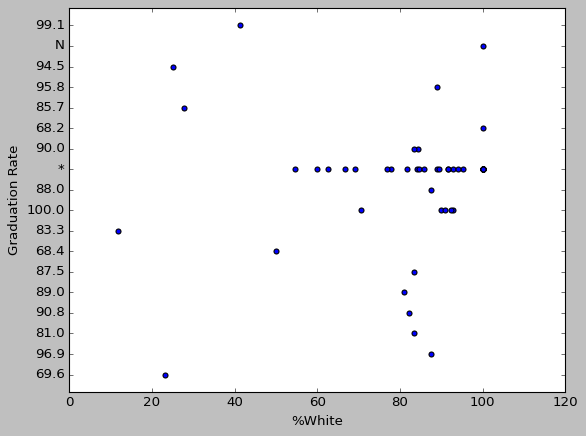

In [51]:
#I couldn't remove the missing variables above, but here's some example scatter plots regardless.
RateIsoWhite.plot(kind='scatter', y='Graduation Rate', x='%White')

<Axes: xlabel='%Black', ylabel='Graduation Rate'>

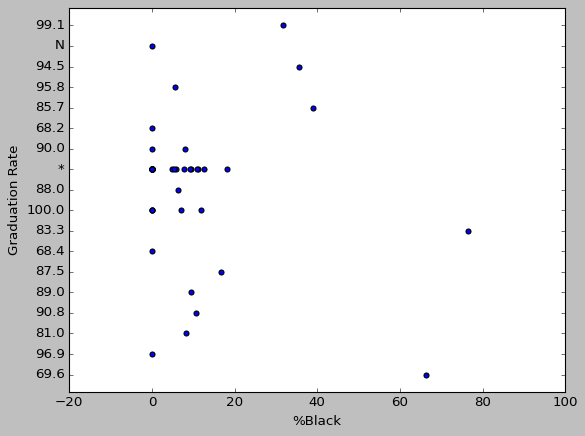

In [52]:
RateIsoBlack.plot(kind='scatter', y='Graduation Rate', x='%Black')

In [53]:
#Couldn't get these to work because of my inability to drop the relevant missing variable meaning pandas didn't automatically sort them by value. Will have to check in later this week, as I was unexpectedly out of town.
#Let's try showing off how much of these variables have missing data.


<Axes: xlabel='Graduation Rate'>

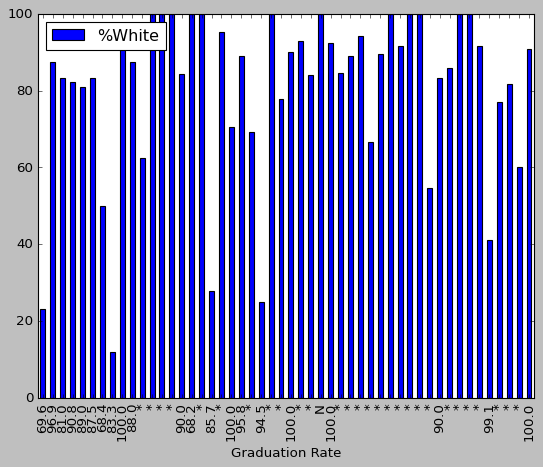

In [54]:
RateIsoWhite.plot(kind='bar', x='Graduation Rate')

In [55]:
#Yeah, that's about what I expected. Trying to tilt it the other way errored on non numeric variables - looks like my data was cooked from not being able to drop that. Will still try to show off what I can.

In [56]:
#let's move onto map/recode next. I want to recode the counties into north and south jersey.
#And then, make another remapped set for those who buy into the myth of central jersey.
BlackMerged

,County,District Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female,District Name,School Name,Student Group,Graduation Rate,Cohort Count,Graduated,_merge
1,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7,Atlantic City School District,District,Black or African American,69.6,138,96,both
2,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0,Atlantic County Vocational School District,District,Black or African American,96.9,65,63,both
5,Atlantic,590.0,Buena Regional School District,Administrators,83.3,8.3,8.3,0.0,58.3,41.7,Buena Regional School District,District,Black or African American,81.0,21,17,both
7,Atlantic,1310.0,Egg Harbor Township School District,Administrators,82.1,10.7,7.1,0.0,42.9,57.1,Egg Harbor Township School District,District,Black or African American,90.8,65,59,both
11,Atlantic,1790.0,Greater Egg Harbor Regional High School District,Administrators,81.0,9.5,9.5,0.0,76.2,23.8,Greater Egg Harbor Regional High School District,District,Black or African American,89.0,172,153,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
646,Charters,7320.0,North Star Academy Charter School,Administrators,50.0,50.0,0.0,0.0,25.0,75.0,North Star Academy Charter School,District,Black or African American,84.8,230,195,both
647,Charters,7325.0,Team Academy Charter School,Administrators,0.0,100.0,0.0,0.0,0.0,100.0,Team Academy Charter School,District,Black or African American,95.1,184,175,both
648,Charters,7410.0,Chartertech High School For The Performing Arts,Administrators,75.0,25.0,0.0,0.0,25.0,75.0,Chartertech High School For The Performing Arts,District,Black or African American,96.6,29,28,both
650,Charters,7503.0,Paterson Charter School For Science And Techno...,Administrators,100.0,0.0,0.0,0.0,85.7,14.3,Paterson Charter School For Science And Techno...,District,Black or African American,97.1,*,*,both


In [57]:
mapping_jersey_real = {'Atlantic':'South'
                              ,'Cumberland':'South'
                              ,'Burlington':'South'
                              ,'Gloucester':'South'
                              ,'Salem':'South'
                              ,'Cape May':'South'
                              ,'Atlantic':'South'
                              ,'Camden':'South'
                              ,'Ocean' : 'South'
                              ,'Bergen':'North'
                              ,'Essex':'North'
                              ,'Hudson':'North'
                              ,'Morris':'North'
                              ,'Passaic':'North'
                              ,'Sussex':'North'
                              ,'Union':'North'
                              ,'Warren':'North'
                              ,'Mercer': 'North'
                              ,'Monmouth' : 'North'
                              ,'Middlesex':'North'
                              ,'Hunterdon':'North'
                              ,'Somerset':'North'}
BlackMergedNS = BlackMerged['County'].map(mapping_jersey_real)

In [58]:
mapping_jersey_fake = {'Atlantic':'South'
                              ,'Cumberland':'South'
                              ,'Burlington':'South'
                              ,'Gloucester':'South'
                              ,'Salem':'South'
                              ,'Cape May':'South'
                              ,'Atlantic':'South'
                              ,'Camden':'South'
                              ,'Ocean' : 'Central'
                              ,'Bergen':'North'
                              ,'Essex':'North'
                              ,'Hudson':'North'
                              ,'Morris':'North'
                              ,'Passaic':'North'
                              ,'Sussex':'North'
                              ,'Union':'North'
                              ,'Warren':'North'
                              ,'Mercer': 'North'
                              ,'Monmouth' : 'Central'
                              ,'Middlesex':'Central'
                              ,'Hunterdon':'Central'
                              ,'Somerset':'Central'}
BlackMergedNSC = BlackMerged['County'].map(mapping_jersey_fake)

In [59]:
BlackMergedNSC

1      South
2      South
5      South
7      South
11     South
       ...  
646      NaN
647      NaN
648      NaN
650      NaN
667      NaN
Name: County, Length: 312, dtype: object

In [60]:
BlackMergedNS

1      South
2      South
5      South
7      South
11     South
       ...  
646      NaN
647      NaN
648      NaN
650      NaN
667      NaN
Name: County, Length: 312, dtype: object

In [61]:
#Now I got both of them to work, but couldn't get them to stay attached to the main document on my own.
#Let's do some simple groupby and agg to make the means and standard deviations, as well as some other useful statistics.

In [62]:
BlackMerged['Graduation Rate'].agg(['sum', 'mean'])
#Another set with problems due to the * variables. Lost more time trying to process it again.


<ipython-input-62-3ac9350680d5>:1: FutureWarning: ['mean'] did not aggregate successfully. If any error is raised this will raise in a future version of pandas. Drop these columns/ops to avoid this warning.
  BlackMerged['Graduation Rate'].agg(['sum', 'mean'])


sum    69.696.981.090.889.087.568.483.3100.088.0****9...
Name: Graduation Rate, dtype: object

In [63]:
BlackMerged['%Black'].agg(['sum', 'mean'])

sum     4001.700000
mean      12.825962
Name: %Black, dtype: float64

In [64]:
agg_func_describe = {'%Black' :['describe']}
BlackMerge.groupby(['District']).agg(agg_func_describe).round(2) #aok: need to groupby sth that is a group eg county: one county has a group (a bunch of) schools

%Black                        \
                                              describe                         
                                                 count  mean std   min   25%   
District                                                                       
Absecon Public Schools District                    1.0   0.0 NaN   0.0   0.0   
Academy Charter High School                        1.0   0.0 NaN   0.0   0.0   
Academy For Urban Leadership Charter School        1.0  50.0 NaN  50.0  50.0   
Achieve Community Charter School                   1.0  83.3 NaN  83.3  83.3   
Achievers Early College Prep Charter School        1.0  83.3 NaN  83.3  83.3   
...                                                ...   ...  ..   ...   ...   
Woodland Park School District                      1.0   0.0 NaN   0.0   0.0   
Woodland Township School District                  1.0   0.0 NaN   0.0   0.0   
Woodlynne School District                          1.0  50.0 NaN  50.0  50.0   
Woodstown-Pilesgrove Regional School District      1.0  11.1 NaN  11.1  11.1   
Wyckoff Township Public School District            1.0   0.0 NaN   0.0   0.0   

                                                                 
                                                                 
                                                50%   75%   max  
District                                                         
Absecon Public Schools District                 0.0   0.0   0.0  
Academy Charter High School                     0.0   0.0   0.0  
Academy For Urban Leadership Charter School    50.0  50.0  50.0  
Achieve Community Charter School               83.3  83.3  83.3  
Achievers Early College Prep Charter School    83.3  83.3  83.3  
...                                             ...   ...   ...  
Woodland Park School District                   0.0   0.0   0.0  
Woodland Township School District               0.0   0.0   0.0  
Woodlynne School District                      50.0  50.0  50.0  
Woodstown-Pilesgrove Regional School District  11.1  11.1  11.1  
Wyckoff Township Public School District         0.0   0.0   0.0  

[664 rows x 8 columns]

In [65]:
#Nope - lost on this. Unfortunate. Turning in what I at least tried to get done.

# can use sec names like thsi ps3

In [66]:
#PS3 Starts here! Merging together the following datasets, all at the county level
#Graduation Rate
#Causes of death
#Food Insecurity
#Agricultural data(Pigs in specific, to serve as a later comparison for overall farm space in a region due to the space they take up)
#Simple census race statistics(Not useful for these, but will be used later to compare with administrative hiring data)
#And for the complex merge, South, North, and Central jersey election and commute times.
#None of these datasets are drawn from previous sources as was required, but most of them are useful to compare to the major DOE datasets later.

#aok:
#but need to say where the data come from like give url to the original data source

In [67]:
#DOE doesn't have the data at County level. Found a database that drew from the DOE sample to present Grad Rates at the county level.
#urllib.request.urlretrieve("https://docs.google.com/uc?id=107VTwNv2HyDMnZk41-h0yD-5T4Nv8v2Z&export=download ", "CountyRates.xlsx")
!wget -q -O CountyRates.xlsx https://docs.google.com/uc?id=107VTwNv2HyDMnZk41-h0yD-5T4Nv8v2Z&export=download

In [68]:
# basic navigation
#wd =  'CountyRates.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
CountyRates.xlsx  GradRate.xlsv  PerPupil.csv  sample_data  Staff.xlsv


In [69]:
dat=pd.read_excel('CountyRates.xlsx', sheet_name='Additional Measure Data',skiprows=[0,2])
#Skipping a junk row and the state level data row.

In [70]:
dat.columns

Index(['FIPS', 'State', 'County', 'Life Expectancy', '95% CI - Low',
       '95% CI - High', 'Life Expectancy (AIAN)',
       'Life Expectancy (AIAN) 95% CI - Low',
       'Life Expectancy (AIAN) 95% CI - High', 'Life Expectancy (Asian)',
       ...
       '% Hispanic', '# Non-Hispanic White', '% Non-Hispanic White',
       '# Not Proficient in English', '% Not Proficient in English',
       '95% CI - Low.21', '95% CI - High.21', '% Female', '# Rural Residents',
       '% Rural'],
      dtype='object', length=288)

In [71]:
CountyGrad=dat[['County','High School Graduation Rate']]

In [72]:
CountyGrad

,County,High School Graduation Rate
0,Atlantic,90.094340
1,Bergen,95.283082
2,Burlington,95.197921
3,Camden,88.195373
4,Cape May,91.222959
5,Cumberland,86.446719
6,Essex,88.256066
7,Gloucester,92.791424
8,Hudson,84.982456
9,Hunterdon,95.920667


In [73]:
#Here's the causes of death in NJ with rates by county.
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1GWBGqsePB4fu1PJ5dwGJonafQc43gDp8&export=download", "Death.xlsx")
!wget -q -O Death.xlsx https://docs.google.com/uc?id=1GWBGqsePB4fu1PJ5dwGJonafQc43gDp8&export=download

In [74]:
# basic navigation
#wd =  'Death.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
CountyRates.xlsx  Death.xlsx  GradRate.xlsv  PerPupil.csv  sample_data	Staff.xlsv


In [75]:
dat=pd.read_excel('Death.xlsx',skiprows=[0,1,2,3,4,5,6], nrows=21) #aok skiprows=6 should do it

In [76]:
dat

,Unnamed: 0,COVID-19 (U07.1),Septicemia (A40-41),Cancer (malignant neoplasms) (C00-C97),Diabetes mellitus (E10-E14),Parkinson's disease (G20-G21),Alzheimer's disease (G30),"Diseases of heart (I00-I09,I11,I13,I20-I51)","Essential hypertension and hypertensive renal disease (I10,I12,I15)",Stroke (cerebrovascular diseases) (I60-I69),...,Chronic lower respiratory diseases (CLRD) (J40-J47),Pneumonitis due to solids and liquids (J69),"Chronic liver disease and cirrhosis (K70,K73-K74)","Nephritis, nephrotic syndrome and nephrosis (kidney disease) (N00-N07,N17-N19,N25-N27)","Unintentional injuries (V01-X59, Y85-Y86)","Suicide (intentional self-harm) (X60-X84,Y87.0)","Homicide (assault) (X85-Y09,Y87.1)",All other coded underlying causes of death,Underlying cause of death not yet coded,Unnamed: 20
0,Atlantic,42,24,365,45,24,54,384,12,67,...,78,13,25,55,66,14,**,511,106,**
1,Hunterdon,**,20,138,18,**,10,141,**,27,...,20,**,11,**,24,14,**,152,48,670
2,Mercer,34,48,387,32,12,52,442,22,82,...,65,14,23,44,106,19,19,465,108,2008
3,Middlesex,86,156,777,96,40,60,909,45,165,...,104,39,45,90,167,32,**,897,206,**
4,Monmouth,74,98,722,70,64,116,863,30,162,...,135,29,41,87,150,27,**,905,224,**
5,Morris,53,78,519,44,39,91,561,25,122,...,66,37,14,52,65,24,**,632,141,**
6,Ocean,58,127,965,89,56,116,1343,48,204,...,204,43,59,125,162,35,**,1014,323,**
7,Passaic,44,41,480,60,28,73,499,36,101,...,72,26,30,50,74,**,**,642,130,2446
8,Salem,**,**,106,21,**,**,102,**,18,...,12,**,**,**,24,**,**,112,32,475
9,Somerset,35,59,323,34,27,41,351,28,101,...,53,27,17,30,50,13,**,416,112,**


In [77]:
dat.columns

Index(['Unnamed: 0', 'COVID-19 (U07.1)', 'Septicemia (A40-41)',
       'Cancer (malignant neoplasms) (C00-C97)', 'Diabetes mellitus (E10-E14)',
       'Parkinson's disease (G20-G21)', 'Alzheimer's disease (G30)',
       'Diseases of heart (I00-I09,I11,I13,I20-I51)',
       'Essential hypertension and hypertensive renal disease (I10,I12,I15)',
       'Stroke (cerebrovascular diseases) (I60-I69)',
       'Influenza and pneumonia (J09-J18)',
       'Chronic lower respiratory diseases (CLRD) (J40-J47)',
       'Pneumonitis due to solids and liquids (J69)',
       'Chronic liver disease and cirrhosis (K70,K73-K74)',
       'Nephritis, nephrotic syndrome and nephrosis (kidney disease) (N00-N07,N17-N19,N25-N27)',
       'Unintentional injuries (V01-X59, Y85-Y86)',
       'Suicide (intentional self-harm) (X60-X84,Y87.0)',
       'Homicide (assault) (X85-Y09,Y87.1)',
       'All other coded underlying causes of death',
       'Underlying cause of death not yet coded', 'Unnamed: 20'],
      dtyp

In [78]:
#Let's slim this down to just some of the more basic variables - COVID, and Diseases of the Heart seem like they'd have things that could be compared to some of the food data we'll be looking at.
DeathCounty=dat[['Unnamed: 0','COVID-19 (U07.1)','Diseases of heart (I00-I09,I11,I13,I20-I51)']]

In [79]:
DeathCounty

,Unnamed: 0,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)"
0,Atlantic,42,384
1,Hunterdon,**,141
2,Mercer,34,442
3,Middlesex,86,909
4,Monmouth,74,863
5,Morris,53,561
6,Ocean,58,1343
7,Passaic,44,499
8,Salem,**,102
9,Somerset,35,351


In [80]:
DeathCounty.rename(columns={'Unnamed: 0':'County'},inplace=True)

<ipython-input-80-55c78103f17d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DeathCounty.rename(columns={'Unnamed: 0':'County'},inplace=True)


In [81]:
DeathCounty
#Rennamed for the merge.
#aok could fix the missing code of ** by replacing it with np.nan

,County,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)"
0,Atlantic,42,384
1,Hunterdon,**,141
2,Mercer,34,442
3,Middlesex,86,909
4,Monmouth,74,863
5,Morris,53,561
6,Ocean,58,1343
7,Passaic,44,499
8,Salem,**,102
9,Somerset,35,351


In [82]:
#Rates of Food Insecurity in NJ by County
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1vJIna5IDtbaLUKpXiGKfd6u9FHU8_BZI&export=download ", "FoodInsec.xlsx")
!wget -q -O FoodInsec.xlsx https://docs.google.com/uc?id=1vJIna5IDtbaLUKpXiGKfd6u9FHU8_BZI&export=download

In [83]:
# basic navigation
#wd =  'FoodInsec.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
CountyRates.xlsx  Death.xlsx  FoodInsec.xlsx  GradRate.xlsv  PerPupil.csv  sample_data	Staff.xlsv


In [84]:
dat=pd.read_excel('FoodInsec.xlsx',
                   sheet_name='County',
                   header=0,
                   skiprows=lambda a: (a > 0 and (a < 1776 or a > 1796)) )
#My tutor saw that the data I wanted to work with had the data and I wanted 1700 entries deep, and only 21 of the total 30000 entries
#Said "I can help you but this will be some WEIRD stuff"
#And proceeded to curse me out for the next 5 minutes as he guided me through how to write this section.
#I added the context here because this is a little beyond what I think you were expecting us to do here.

In [85]:
dat
#Reading in the County level data went fine, but we've got too many variables. Let's run our list and slim.

,FIPS,State,"County, State",Year,Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",Low Threshold in state,...,% FI Btwn Thresholds,% FI > High Threshold,% FI > Low Threshold,Child Food Insecurity Rate,# of Food Insecure Children,% food insecure children in HH w/ HH incomes below 185 FPL,% food insecure children in HH w/ HH incomes above 185 FPL,Cost Per Meal,Weighted weekly $ needed by FI,Weighted Annual Food Budget Shortfall
0,34001,NJ,"Atlantic County, New Jersey",2021,0.112,30810,0.20,0.19,0.06,1.85,...,NaN,NaN,0.266,0.151,8800,0.80,0.20,3.87,22.568465,21092000
1,34003,NJ,"Bergen County, New Jersey",2021,0.067,64240,0.11,0.12,0.03,1.85,...,NaN,NaN,0.467,0.036,7370,1.00,0.00,4.29,24.965828,48649000
2,34005,NJ,"Burlington County, New Jersey",2021,0.056,25920,0.09,0.13,0.03,1.85,...,NaN,NaN,0.409,0.067,6410,0.81,0.20,3.97,23.139884,18194000
3,34007,NJ,"Camden County, New Jersey",2021,0.091,47500,0.16,0.19,0.05,1.85,...,NaN,NaN,0.299,0.123,14720,0.77,0.23,4.09,23.825587,34329000
4,34009,NJ,"Cape May County, New Jersey",2021,0.099,9450,0.20,0.16,0.06,1.85,...,NaN,NaN,0.319,0.111,1870,0.82,0.18,4.33,25.228162,7232000
5,34011,NJ,"Cumberland County, New Jersey",2021,0.104,16080,0.22,0.17,0.06,1.85,...,NaN,NaN,0.155,0.160,6020,0.89,0.11,3.60,20.952906,10220000
6,34013,NJ,"Essex County, New Jersey",2021,0.099,84450,0.21,0.17,0.04,1.85,...,NaN,NaN,0.321,0.170,34710,0.73,0.27,4.40,25.630752,65657000
7,34015,NJ,"Gloucester County, New Jersey",2021,0.066,19880,0.14,0.14,0.03,1.85,...,NaN,NaN,0.392,0.059,3900,0.91,0.09,3.79,22.061979,13304000
8,34017,NJ,"Hudson County, New Jersey",2021,0.110,78150,0.19,0.16,0.07,1.85,...,NaN,NaN,0.305,0.130,19000,0.85,0.15,3.79,22.069771,52317000
9,34019,NJ,"Hunterdon County, New Jersey",2021,0.046,5910,0.08,0.09,0.01,1.85,...,NaN,NaN,0.501,0.000,0,NaN,NaN,4.08,23.791821,4265000


In [86]:
dat.columns

Index(['FIPS', 'State', 'County, State', 'Year',
       'Overall Food Insecurity Rate', '# of Food Insecure Persons Overall',
       'Food Insecurity Rate among Black Persons (all ethnicities)',
       'Food Insecurity Rate among Hispanic Persons (any race)',
       'Food Insecurity Rate among White, non-Hispanic Persons ',
       'Low Threshold in state', 'Low Threshold Type',
       'High Threshold in state', 'High Threshold Type',
       '% FI ≤ Low Threshold', '% FI Btwn Thresholds', '% FI > High Threshold',
       '% FI > Low Threshold', 'Child Food Insecurity Rate',
       '# of Food Insecure Children',
       '% food insecure children in HH w/ HH incomes below 185 FPL',
       '% food insecure children in HH w/ HH incomes above 185 FPL',
       'Cost Per Meal', 'Weighted weekly $ needed by FI',
       'Weighted Annual Food Budget Shortfall'],
      dtype='object')

In [87]:
FoodInsecClean=dat[['County, State','Overall Food Insecurity Rate', '# of Food Insecure Persons Overall',
       'Food Insecurity Rate among Black Persons (all ethnicities)',
       'Food Insecurity Rate among Hispanic Persons (any race)',
       'Food Insecurity Rate among White, non-Hispanic Persons ', '# of Food Insecure Children']]

In [88]:
FoodInsecClean
#Now there's only one issue - the 'County, New Jersey' tagged onto the end of each of these will make it so they don't merge

,"County, State",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children
0,"Atlantic County, New Jersey",0.112,30810,0.20,0.19,0.06,8800
1,"Bergen County, New Jersey",0.067,64240,0.11,0.12,0.03,7370
2,"Burlington County, New Jersey",0.056,25920,0.09,0.13,0.03,6410
3,"Camden County, New Jersey",0.091,47500,0.16,0.19,0.05,14720
4,"Cape May County, New Jersey",0.099,9450,0.20,0.16,0.06,1870
5,"Cumberland County, New Jersey",0.104,16080,0.22,0.17,0.06,6020
6,"Essex County, New Jersey",0.099,84450,0.21,0.17,0.04,34710
7,"Gloucester County, New Jersey",0.066,19880,0.14,0.14,0.03,3900
8,"Hudson County, New Jersey",0.110,78150,0.19,0.16,0.07,19000
9,"Hunterdon County, New Jersey",0.046,5910,0.08,0.09,0.01,0


In [89]:
FoodInsec = FoodInsecClean.replace(to_replace=" County, New Jersey", value="", regex=True)
#This should chop just that part off and leave us with a mergable variable.
#aok: nice!

In [90]:
FoodInsec
#Perfect. All of the variables preserved in a mergable state.

,"County, State",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children
0,Atlantic,0.112,30810,0.20,0.19,0.06,8800
1,Bergen,0.067,64240,0.11,0.12,0.03,7370
2,Burlington,0.056,25920,0.09,0.13,0.03,6410
3,Camden,0.091,47500,0.16,0.19,0.05,14720
4,Cape May,0.099,9450,0.20,0.16,0.06,1870
5,Cumberland,0.104,16080,0.22,0.17,0.06,6020
6,Essex,0.099,84450,0.21,0.17,0.04,34710
7,Gloucester,0.066,19880,0.14,0.14,0.03,3900
8,Hudson,0.110,78150,0.19,0.16,0.07,19000
9,Hunterdon,0.046,5910,0.08,0.09,0.01,0


In [91]:
FoodInsec.rename(columns={'County, State':'County'},inplace=True)
#Changing the column name for merging.

In [92]:
FoodInsec

,County,Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children
0,Atlantic,0.112,30810,0.20,0.19,0.06,8800
1,Bergen,0.067,64240,0.11,0.12,0.03,7370
2,Burlington,0.056,25920,0.09,0.13,0.03,6410
3,Camden,0.091,47500,0.16,0.19,0.05,14720
4,Cape May,0.099,9450,0.20,0.16,0.06,1870
5,Cumberland,0.104,16080,0.22,0.17,0.06,6020
6,Essex,0.099,84450,0.21,0.17,0.04,34710
7,Gloucester,0.066,19880,0.14,0.14,0.03,3900
8,Hudson,0.110,78150,0.19,0.16,0.07,19000
9,Hunterdon,0.046,5910,0.08,0.09,0.01,0


In [93]:
#Some basic agricultural data - filtered down to just pigs. In future, will do multiple merges to pull in all livestock data into one databank
#The state's website limits it to only a certain number of entries per pull, so I'll have to stitch them together to get the numbers I want
#It notably doesn't include every County in the state, so we'll be missing a few later on - specificially Bergen, Hudson, and Union.
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1HC2Z7yNDjQ8x8Bbk6BXMGiwzVlmD0sDX&export=download ", "Hogs.csv")
!wget -q -O Hogs.csv https://docs.google.com/uc?id=1HC2Z7yNDjQ8x8Bbk6BXMGiwzVlmD0sDX&export=download

In [94]:
# basic navigation
#wd =  'FoodInsec.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
CountyRates.xlsx  FoodInsec.xlsx  Hogs.csv	sample_data
Death.xlsx	  GradRate.xlsv   PerPupil.csv	Staff.xlsv


In [95]:
dat=pd.read_csv('Hogs.csv')

In [96]:
dat.columns

Index(['Program', 'Year', 'Period', 'Week Ending', 'Geo Level', 'State',
       'State ANSI', 'Ag District', 'Ag District Code', 'County',
       'County ANSI', 'Zip Code', 'Region', 'watershed_code', 'Watershed',
       'Commodity', 'Data Item', 'Domain', 'Domain Category', 'Value',
       'CV (%)'],
      dtype='object')

In [97]:
HogsClean=dat[['Year','County','Value','CV (%)']]

In [98]:
HogsClean

,Year,County,Value,CV (%)
0,2017,BURLINGTON,"2,025",32.3
1,2017,MERCER,(D),(D)
2,2017,MIDDLESEX,(D),(D)
3,2017,MONMOUTH,51,32.3
4,2017,OCEAN,314,32.3
...,...,...,...,...
534,1971,ATLANTIC,"1,300",NaN
535,1971,CAMDEN,"1,000",NaN
536,1971,CAPE MAY,"4,700",NaN
537,1971,CUMBERLAND,"1,200",NaN


In [99]:
#Restricted down to the useful bits we needed. Now let's narrow it down to one year! If I wanted, I code do this multiple times and then remerge them so their more comparable line wise.
#No ' around 2017 because it's a number.
Hogs2017=HogsClean[dat['Year']==2017]

In [100]:
Hogs2017
#Perfect. The missing variables represent counties with no hogs - I know how to filter that out to a 0 but haven't here because I want to do it on a larger scale when I have them all together.
#Looks good - but, we can't merge these with the Counties capitalized. Looks like we'll have to filter them back to title case.

,Year,County,Value,CV (%)
0,2017,BURLINGTON,"2,025",32.3
1,2017,MERCER,(D),(D)
2,2017,MIDDLESEX,(D),(D)
3,2017,MONMOUTH,51,32.3
4,2017,OCEAN,314,32.3
5,2017,ESSEX,3,32.3
6,2017,HUNTERDON,761,32.3
7,2017,MORRIS,165,32.3
8,2017,PASSAIC,42,32.3
9,2017,SOMERSET,919,32.3


In [101]:
Hogs2017["County"]=Hogs2017["County"].str.title()

<ipython-input-101-b43a22728675>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Hogs2017["County"]=Hogs2017["County"].str.title()


In [102]:
Hogs2017

,Year,County,Value,CV (%)
0,2017,Burlington,"2,025",32.3
1,2017,Mercer,(D),(D)
2,2017,Middlesex,(D),(D)
3,2017,Monmouth,51,32.3
4,2017,Ocean,314,32.3
5,2017,Essex,3,32.3
6,2017,Hunterdon,761,32.3
7,2017,Morris,165,32.3
8,2017,Passaic,42,32.3
9,2017,Somerset,919,32.3


In [103]:
#Loading in the Census Race data for comparison's death
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1_QQGO7UjmWJUp8m-CieMkLe4G1cYK4mI&export=download ", "Census.csv")
!wget -q -O Census.csv https://docs.google.com/uc?id=1_QQGO7UjmWJUp8m-CieMkLe4G1cYK4mI&export=download

In [104]:
# basic navigation
#wd =  'FoodInsec.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
Census.csv	  Death.xlsx	  GradRate.xlsv  PerPupil.csv  Staff.xlsv
CountyRates.xlsx  FoodInsec.xlsx  Hogs.csv	 sample_data


In [105]:
dat=pd.read_csv('Census.csv',skiprows=1)

In [106]:
dat

,Geography,Geographic Area Name,!!Total:,Annotation of !!Total:,!!Total:!!Population of one race:,Annotation of !!Total:!!Population of one race:,!!Total:!!Population of one race:!!White alone,Annotation of !!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone,Annotation of !!Total:!!Population of one race:!!Black or African American alone,...,Annotation of !!Total:!!Population of two or more races:!!Population of five races:!!White; Black or African American; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,!!Total:!!Population of two or more races:!!Population of five races:!!White; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,Annotation of !!Total:!!Population of two or more races:!!Population of five races:!!White; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,!!Total:!!Population of two or more races:!!Population of five races:!!Black or African American; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,Annotation of !!Total:!!Population of two or more races:!!Population of five races:!!Black or African American; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,!!Total:!!Population of two or more races:!!Population of six races:,Annotation of !!Total:!!Population of two or more races:!!Population of six races:,!!Total:!!Population of two or more races:!!Population of six races:!!White; Black or African American; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,Annotation of !!Total:!!Population of two or more races:!!Population of six races:!!White; Black or African American; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race,Unnamed: 144
0,0500000US34001,"Atlantic County, New Jersey",274534,NaN,248886,NaN,156796,NaN,41519,NaN,...,NaN,1,NaN,0,NaN,0,NaN,0,NaN,NaN
1,0500000US34003,"Bergen County, New Jersey",955732,NaN,858445,NaN,543849,NaN,54831,NaN,...,NaN,0,NaN,0,NaN,4,NaN,4,NaN,NaN
2,0500000US34005,"Burlington County, New Jersey",461860,NaN,424520,NaN,303024,NaN,77749,NaN,...,NaN,0,NaN,0,NaN,11,NaN,11,NaN,NaN
3,0500000US34007,"Camden County, New Jersey",523485,NaN,480854,NaN,293198,NaN,101109,NaN,...,NaN,6,NaN,0,NaN,5,NaN,5,NaN,NaN
4,0500000US34009,"Cape May County, New Jersey",95263,NaN,89588,NaN,81536,NaN,3567,NaN,...,NaN,0,NaN,0,NaN,0,NaN,0,NaN,NaN
5,0500000US34011,"Cumberland County, New Jersey",154152,NaN,135746,NaN,74606,NaN,28581,NaN,...,NaN,3,NaN,0,NaN,0,NaN,0,NaN,NaN
6,0500000US34013,"Essex County, New Jersey",863728,NaN,773192,NaN,261487,NaN,335047,NaN,...,NaN,1,NaN,0,NaN,7,NaN,7,NaN,NaN
7,0500000US34015,"Gloucester County, New Jersey",302294,NaN,281793,NaN,230313,NaN,32992,NaN,...,NaN,3,NaN,2,NaN,0,NaN,0,NaN,NaN
8,0500000US34017,"Hudson County, New Jersey",724854,NaN,620369,NaN,248561,NaN,79498,NaN,...,NaN,5,NaN,0,NaN,13,NaN,13,NaN,NaN
9,0500000US34019,"Hunterdon County, New Jersey",128947,NaN,120088,NaN,106790,NaN,3174,NaN,...,NaN,2,NaN,2,NaN,3,NaN,3,NaN,NaN


In [107]:
dat.columns

Index(['Geography', 'Geographic Area Name', ' !!Total:',
       'Annotation of  !!Total:', ' !!Total:!!Population of one race:',
       'Annotation of  !!Total:!!Population of one race:',
       ' !!Total:!!Population of one race:!!White alone',
       'Annotation of  !!Total:!!Population of one race:!!White alone',
       ' !!Total:!!Population of one race:!!Black or African American alone',
       'Annotation of  !!Total:!!Population of one race:!!Black or African American alone',
       ...
       'Annotation of  !!Total:!!Population of two or more races:!!Population of five races:!!White; Black or African American; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race',
       ' !!Total:!!Population of two or more races:!!Population of five races:!!White; American Indian and Alaska Native; Asian; Native Hawaiian and Other Pacific Islander; Some Other Race',
       'Annotation of  !!Total:!!Population of two or more races:!!Population of five races:!!White; American Ind

In [108]:
CensusWhiteBlackUncut=dat[['Geographic Area Name',' !!Total:!!Population of one race:!!White alone',' !!Total:!!Population of one race:!!Black or African American alone']]

In [109]:
CensusWhiteBlackUncut
#Same issue with Foodinsec. Luckily, we have the exact code written out already!

,Geographic Area Name,!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone
0,"Atlantic County, New Jersey",156796,41519
1,"Bergen County, New Jersey",543849,54831
2,"Burlington County, New Jersey",303024,77749
3,"Camden County, New Jersey",293198,101109
4,"Cape May County, New Jersey",81536,3567
5,"Cumberland County, New Jersey",74606,28581
6,"Essex County, New Jersey",261487,335047
7,"Gloucester County, New Jersey",230313,32992
8,"Hudson County, New Jersey",248561,79498
9,"Hunterdon County, New Jersey",106790,3174


In [110]:
CensusWhiteBlack = CensusWhiteBlackUncut.replace(to_replace=" County, New Jersey", value="", regex=True)

In [111]:
CensusWhiteBlack
#And that's our five done for our basic merge. Let's stitch these all together before doing the complex.

,Geographic Area Name,!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone
0,Atlantic,156796,41519
1,Bergen,543849,54831
2,Burlington,303024,77749
3,Camden,293198,101109
4,Cape May,81536,3567
5,Cumberland,74606,28581
6,Essex,261487,335047
7,Gloucester,230313,32992
8,Hudson,248561,79498
9,Hunterdon,106790,3174


In [112]:
CensusWhiteBlack.rename(columns={'Geographic Area Name':'County'},inplace=True)
#Changing the column name for merging.

In [113]:
CensusWhiteBlack

,County,!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone
0,Atlantic,156796,41519
1,Bergen,543849,54831
2,Burlington,303024,77749
3,Camden,293198,101109
4,Cape May,81536,3567
5,Cumberland,74606,28581
6,Essex,261487,335047
7,Gloucester,230313,32992
8,Hudson,248561,79498
9,Hunterdon,106790,3174


In [114]:
 GradDeath = pd.merge(CountyGrad, DeathCounty, how='left', on=['County'], indicator=True)
 #Noting all five of my datasets in order and their variable names for proper merging - 'CountyGrad', 'DeathCounty', 'FoodInsec', 'Hogs2017', 'CensusWhiteBlack'

In [115]:
GradDeath
#Grad rates and death merged off of county!

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",_merge
0,Atlantic,90.094340,42,384,both
1,Bergen,95.283082,89,980,both
2,Burlington,95.197921,49,619,both
3,Camden,88.195373,39,648,both
4,Cape May,91.222959,**,179,both
5,Cumberland,86.446719,12,202,both
6,Essex,88.256066,49,705,both
7,Gloucester,92.791424,24,384,both
8,Hudson,84.982456,38,535,both
9,Hunterdon,95.920667,**,141,both


In [116]:
GradDeathClean=GradDeath[['County', 'High School Graduation Rate', 'COVID-19 (U07.1)',
       'Diseases of heart (I00-I09,I11,I13,I20-I51)']]

In [117]:
GradDeathClean["County"] == FoodInsec["County"]

0     True
1     True
2     True
3     True
4     True
5     True
6     True
7     True
8     True
9     True
10    True
11    True
12    True
13    True
14    True
15    True
16    True
17    True
18    True
19    True
20    True
Name: County, dtype: bool

In [118]:
 GradDeathFood = pd.merge(GradDeathClean, FoodInsec, how='left', on=['County'], indicator=True)


In [119]:
GradDeathFood
#Worked! This one took 30 minutes for reasons I don't want to elaborate on out of fear of looking stupid.

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children,_merge
0,Atlantic,90.094340,42,384,0.112,30810,0.20,0.19,0.06,8800,both
1,Bergen,95.283082,89,980,0.067,64240,0.11,0.12,0.03,7370,both
2,Burlington,95.197921,49,619,0.056,25920,0.09,0.13,0.03,6410,both
3,Camden,88.195373,39,648,0.091,47500,0.16,0.19,0.05,14720,both
4,Cape May,91.222959,**,179,0.099,9450,0.20,0.16,0.06,1870,both
5,Cumberland,86.446719,12,202,0.104,16080,0.22,0.17,0.06,6020,both
6,Essex,88.256066,49,705,0.099,84450,0.21,0.17,0.04,34710,both
7,Gloucester,92.791424,24,384,0.066,19880,0.14,0.14,0.03,3900,both
8,Hudson,84.982456,38,535,0.110,78150,0.19,0.16,0.07,19000,both
9,Hunterdon,95.920667,**,141,0.046,5910,0.08,0.09,0.01,0,both


In [120]:
 GradDeathFoodAgri = pd.merge(GradDeathFood, Hogs2017, how='outer', on=['County'], indicator=False)

In [121]:
GradDeathFoodAgri

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children,_merge,Year,Value,CV (%)
0,Atlantic,90.094340,42,384,0.112,30810,0.20,0.19,0.06,8800,both,2017.0,(D),(D)
1,Bergen,95.283082,89,980,0.067,64240,0.11,0.12,0.03,7370,both,NaN,NaN,NaN
2,Burlington,95.197921,49,619,0.056,25920,0.09,0.13,0.03,6410,both,2017.0,"2,025",32.3
3,Camden,88.195373,39,648,0.091,47500,0.16,0.19,0.05,14720,both,2017.0,(D),(D)
4,Cape May,91.222959,**,179,0.099,9450,0.20,0.16,0.06,1870,both,2017.0,665,32.3
5,Cumberland,86.446719,12,202,0.104,16080,0.22,0.17,0.06,6020,both,2017.0,113,32.3
6,Essex,88.256066,49,705,0.099,84450,0.21,0.17,0.04,34710,both,2017.0,3,32.3
7,Gloucester,92.791424,24,384,0.066,19880,0.14,0.14,0.03,3900,both,2017.0,939,32.3
8,Hudson,84.982456,38,535,0.110,78150,0.19,0.16,0.07,19000,both,NaN,NaN,NaN
9,Hunterdon,95.920667,**,141,0.046,5910,0.08,0.09,0.01,0,both,2017.0,761,32.3


In [122]:
 GradDeathFoodAgriRace = pd.merge(GradDeathFoodAgri, CensusWhiteBlack, how='outer', on=['County'], indicator=False)

In [123]:
 GradDeathFoodAgriRace
 #And that's all five of our basic datasets merged. Let's do some mapping to assign South/Central/North jersey to these, and add on our one to many merge.

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children,_merge,Year,Value,CV (%),!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone
0,Atlantic,90.094340,42,384,0.112,30810,0.20,0.19,0.06,8800,both,2017.0,(D),(D),156796,41519
1,Bergen,95.283082,89,980,0.067,64240,0.11,0.12,0.03,7370,both,NaN,NaN,NaN,543849,54831
2,Burlington,95.197921,49,619,0.056,25920,0.09,0.13,0.03,6410,both,2017.0,"2,025",32.3,303024,77749
3,Camden,88.195373,39,648,0.091,47500,0.16,0.19,0.05,14720,both,2017.0,(D),(D),293198,101109
4,Cape May,91.222959,**,179,0.099,9450,0.20,0.16,0.06,1870,both,2017.0,665,32.3,81536,3567
5,Cumberland,86.446719,12,202,0.104,16080,0.22,0.17,0.06,6020,both,2017.0,113,32.3,74606,28581
6,Essex,88.256066,49,705,0.099,84450,0.21,0.17,0.04,34710,both,2017.0,3,32.3,261487,335047
7,Gloucester,92.791424,24,384,0.066,19880,0.14,0.14,0.03,3900,both,2017.0,939,32.3,230313,32992
8,Hudson,84.982456,38,535,0.110,78150,0.19,0.16,0.07,19000,both,NaN,NaN,NaN,248561,79498
9,Hunterdon,95.920667,**,141,0.046,5910,0.08,0.09,0.01,0,both,2017.0,761,32.3,106790,3174


In [124]:
#Uploading in some housing, election, and commuting data for Central, South, and North jersey.
#urllib.request.urlretrieve("https://docs.google.com/uc?id=1t6lGdflgCdisu5EzohDSMA2GmEx5MlVZ&export=download  ", "SCN.csv")
!wget -q -O SCN.csv https://docs.google.com/uc?id=1t6lGdflgCdisu5EzohDSMA2GmEx5MlVZ&export=download

In [125]:
# basic navigation
#wd =  'FoodInsec.xlsx'  #'C:\Users\ref\Desktop\junk' # may need to ADJUST
#os.makedirs(wd)
#os.getcwd() #pwd
!pwd
#os.listdir() #compare to clicking on the left the folder icon #dir
!ls
#os.chdir(wd)
#os.getcwd()

/content
Census.csv	  Death.xlsx	  GradRate.xlsv  PerPupil.csv  SCN.csv
CountyRates.xlsx  FoodInsec.xlsx  Hogs.csv	 sample_data   Staff.xlsv


In [126]:
dat=pd.read_csv('SCN.csv')

In [127]:
dat
#Looks good, no major edits needed, and I like all of the variables for future use.

,Section,Population (2013),Total Area (Sq. mi),Ave. Commute (Min),Ave. Property Taxes,Ave. Property Value,% Votes for Christie (2013)
0,Northern,3866532,2274.79,31.73,9737,393672,57
1,Central,3042937,2212.66,31.12,8437,370264,64
2,Southern,1922937,3355.68,26.73,5757,253866,63


In [128]:
SCNCommuteElection=dat

In [129]:
SCNCommuteElection
#Pulling this out into it's own dataset to not cause any conflicts.

,Section,Population (2013),Total Area (Sq. mi),Ave. Commute (Min),Ave. Property Taxes,Ave. Property Value,% Votes for Christie (2013)
0,Northern,3866532,2274.79,31.73,9737,393672,57
1,Central,3042937,2212.66,31.12,8437,370264,64
2,Southern,1922937,3355.68,26.73,5757,253866,63


In [130]:
mapping_jersey_SCN = {'Atlantic':'Southern'
                              ,'Cumberland':'Southern'
                              ,'Burlington':'Southern'
                              ,'Gloucester':'Southern'
                              ,'Salem':'Southern'
                              ,'Cape May':'Southern'
                              ,'Atlantic':'Southern'
                              ,'Camden':'Southern'
                              ,'Ocean' : 'Central'
                              ,'Bergen':'Northern'
                              ,'Essex':'Northern'
                              ,'Hudson':'Northern'
                              ,'Morris':'Northern'
                              ,'Passaic':'Northern'
                              ,'Sussex':'Northern'
                              ,'Union':'Northern'
                              ,'Warren':'Northern'
                              ,'Mercer': 'Northern'
                              ,'Monmouth' : 'Central'
                              ,'Middlesex':'Central'
                              ,'Hunterdon':'Central'
                              ,'Somerset':'Central'}

In [131]:
GradDeathFoodAgriRace["SCN"]=GradDeathFoodAgriRace["County"].map(mapping_jersey_SCN)

In [132]:
GradDeathFoodAgriRace
#Mapping on Southern, Northern, and Central as a new attribute using the map I made earlier in the semester.
#I had intended to use the Agricultural data, as it has this attribute built in, but since it's missing counties
#I had to make my own and attach it.

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children,_merge,Year,Value,CV (%),!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone,SCN
0,Atlantic,90.094340,42,384,0.112,30810,0.20,0.19,0.06,8800,both,2017.0,(D),(D),156796,41519,Southern
1,Bergen,95.283082,89,980,0.067,64240,0.11,0.12,0.03,7370,both,NaN,NaN,NaN,543849,54831,Northern
2,Burlington,95.197921,49,619,0.056,25920,0.09,0.13,0.03,6410,both,2017.0,"2,025",32.3,303024,77749,Southern
3,Camden,88.195373,39,648,0.091,47500,0.16,0.19,0.05,14720,both,2017.0,(D),(D),293198,101109,Southern
4,Cape May,91.222959,**,179,0.099,9450,0.20,0.16,0.06,1870,both,2017.0,665,32.3,81536,3567,Southern
5,Cumberland,86.446719,12,202,0.104,16080,0.22,0.17,0.06,6020,both,2017.0,113,32.3,74606,28581,Southern
6,Essex,88.256066,49,705,0.099,84450,0.21,0.17,0.04,34710,both,2017.0,3,32.3,261487,335047,Northern
7,Gloucester,92.791424,24,384,0.066,19880,0.14,0.14,0.03,3900,both,2017.0,939,32.3,230313,32992,Southern
8,Hudson,84.982456,38,535,0.110,78150,0.19,0.16,0.07,19000,both,NaN,NaN,NaN,248561,79498,Northern
9,Hunterdon,95.920667,**,141,0.046,5910,0.08,0.09,0.01,0,both,2017.0,761,32.3,106790,3174,Central


In [133]:
SCNCommuteElection

,Section,Population (2013),Total Area (Sq. mi),Ave. Commute (Min),Ave. Property Taxes,Ave. Property Value,% Votes for Christie (2013)
0,Northern,3866532,2274.79,31.73,9737,393672,57
1,Central,3042937,2212.66,31.12,8437,370264,64
2,Southern,1922937,3355.68,26.73,5757,253866,63


In [134]:
SCN5Merge=pd.merge(GradDeathFoodAgriRace,SCNCommuteElection, how="left", left_on="SCN", right_on="Section",validate="m:1")
#aok: ok fine it did work out here but again always first do merge with outer option

In [135]:
SCN5Merge

,County,High School Graduation Rate,COVID-19 (U07.1),"Diseases of heart (I00-I09,I11,I13,I20-I51)",Overall Food Insecurity Rate,# of Food Insecure Persons Overall,Food Insecurity Rate among Black Persons (all ethnicities),Food Insecurity Rate among Hispanic Persons (any race),"Food Insecurity Rate among White, non-Hispanic Persons",# of Food Insecure Children,...,!!Total:!!Population of one race:!!White alone,!!Total:!!Population of one race:!!Black or African American alone,SCN,Section,Population (2013),Total Area (Sq. mi),Ave. Commute (Min),Ave. Property Taxes,Ave. Property Value,% Votes for Christie (2013)
0,Atlantic,90.094340,42,384,0.112,30810,0.20,0.19,0.06,8800,...,156796,41519,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
1,Bergen,95.283082,89,980,0.067,64240,0.11,0.12,0.03,7370,...,543849,54831,Northern,Northern,3866532,2274.79,31.73,9737,393672,57
2,Burlington,95.197921,49,619,0.056,25920,0.09,0.13,0.03,6410,...,303024,77749,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
3,Camden,88.195373,39,648,0.091,47500,0.16,0.19,0.05,14720,...,293198,101109,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
4,Cape May,91.222959,**,179,0.099,9450,0.20,0.16,0.06,1870,...,81536,3567,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
5,Cumberland,86.446719,12,202,0.104,16080,0.22,0.17,0.06,6020,...,74606,28581,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
6,Essex,88.256066,49,705,0.099,84450,0.21,0.17,0.04,34710,...,261487,335047,Northern,Northern,3866532,2274.79,31.73,9737,393672,57
7,Gloucester,92.791424,24,384,0.066,19880,0.14,0.14,0.03,3900,...,230313,32992,Southern,Southern,1922937,3355.68,26.73,5757,253866,63
8,Hudson,84.982456,38,535,0.110,78150,0.19,0.16,0.07,19000,...,248561,79498,Northern,Northern,3866532,2274.79,31.73,9737,393672,57
9,Hunterdon,95.920667,**,141,0.046,5910,0.08,0.09,0.01,0,...,106790,3174,Central,Central,3042937,2212.66,31.12,8437,370264,64


In [136]:
SCN5Merge.columns

Index(['County', 'High School Graduation Rate', 'COVID-19 (U07.1)',
       'Diseases of heart (I00-I09,I11,I13,I20-I51)',
       'Overall Food Insecurity Rate', '# of Food Insecure Persons Overall',
       'Food Insecurity Rate among Black Persons (all ethnicities)',
       'Food Insecurity Rate among Hispanic Persons (any race)',
       'Food Insecurity Rate among White, non-Hispanic Persons ',
       '# of Food Insecure Children', '_merge', 'Year', 'Value', 'CV (%)',
       ' !!Total:!!Population of one race:!!White alone',
       ' !!Total:!!Population of one race:!!Black or African American alone',
       'SCN', 'Section', 'Population (2013)', 'Total Area (Sq. mi)',
       'Ave. Commute (Min)', 'Ave. Property Taxes', 'Ave. Property Value',
       '% Votes for Christie (2013)'],
      dtype='object')

In [137]:
#Everything preserved! Looks good and means I can preform some more experimentation on it in the future.
#Some minor things I'll need to fix before preforming descriptive stats on it - IE, replacing missing variables with 0s and such, but I'm happy with this where it is.


# PS4 Starts Here


In [138]:
DistrictWhiteStaffSeperated = AllStaffClean.pivot_table(index="District", columns="Position", values="%White")
#Made a simple pivot table - this one will allow me to now DIRECTLY compare the averages of racial data from job to job.
#IE: Does having more white admins mean that you're more likely to see white teachers and coordinators?

In [139]:
DistrictWhiteStaffSeperated

Position,Administrators,Special Service,Supervisors/Coordinators,Teacher
District,,,,
Absecon Public Schools District,100.0,95.1,100.0,95.6
Academy Charter High School,100.0,53.5,100.0,94.3
Academy For Urban Leadership Charter School,25.0,60.0,0.0,73.1
Achieve Community Charter School,0.0,0.0,0.0,30.0
Achievers Early College Prep Charter School,0.0,20.0,0.0,65.0
...,...,...,...,...
Woodland Park School District,85.7,93.0,100.0,95.4
Woodland Township School District,100.0,100.0,100.0,100.0
Woodlynne School District,50.0,60.0,0.0,92.1


In [140]:
StaffPercentMelted = AllStaffClean.melt(id_vars=['District','Position'])
#Original variable name: WaterAppliedToWitch
#This takes each of the columns of that district level data, and then seperates each into it's own row to allow for some easier comparisons. One of my immediate ideas
#Is to use this to filter it down to just any value of 0, and then counting how often each variable appears
#Which could then be tracked to see which roles are underrepresented across each school district
#Note: I'd also have to filter out the County section in variable, which is easy enough.

In [141]:
StaffPercentMelted

,District,Position,variable,value
0,Absecon Public Schools District,Administrators,County,Atlantic
1,Absecon Public Schools District,Special Service,County,Atlantic
2,Absecon Public Schools District,Teacher,County,Atlantic
3,Absecon Public Schools District,Supervisors/Coordinators,County,Atlantic
4,Atlantic City School District,Administrators,County,Atlantic
...,...,...,...,...
21411,The Village Charter School,Administrators,%Female,100.0
21412,The Village Charter School,Special Service,%Female,100.0
21413,The Village Charter School,Teacher,%Female,83.3
21414,The Village Charter School,Supervisors/Coordinators,%Female,100.0


In [156]:
ProfileReport(AllStaffClean, title="Data. Data about Districts")
#Trying out the profile tool - this was more of a test one to see if I could get it to work. I could. Let's modify this down very quickly to instead be based on each of the four categories of positions and run it again.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [146]:
#Refining the dataset to only include Administrators
DistrictAdmin=AllStaffClean[AllStaffClean['Position']=='Administrators']

In [147]:
DistrictAdmin

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
0,Atlantic,10.0,Absecon Public Schools District,Administrators,100.0,0.0,0.0,0.0,40.0,60.0
4,Atlantic,110.0,Atlantic City School District,Administrators,23.1,66.2,4.6,0.0,32.3,67.7
8,Atlantic,120.0,Atlantic County Vocational School District,Administrators,87.5,0.0,0.0,12.5,75.0,25.0
12,Atlantic,125.0,Atlantic County Special Services School District,Administrators,100.0,0.0,0.0,0.0,75.0,25.0
16,Atlantic,570.0,Brigantine Public School District,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
...,...,...,...,...,...,...,...,...,...,...
2656,Charters,7896.0,Middlesex County Stem Charter School,Administrators,100.0,0.0,0.0,0.0,100.0,0.0
2660,Charters,7897.0,Creativity Colaboratory Charter School,Administrators,0.0,0.0,0.0,0.0,0.0,0.0
2664,Charters,8050.0,Unity Charter School,Administrators,50.0,0.0,50.0,0.0,50.0,50.0
2668,Charters,8060.0,University Academy Charter High School,Administrators,40.0,20.0,40.0,0.0,40.0,60.0


In [157]:
ProfileReport(DistrictAdmin, title="Data. Data about District Admins.")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [150]:
#Refining the dataset to only include Teachers
DistrictTeacher=AllStaffClean[AllStaffClean['Position']=='Teacher']

In [151]:
DistrictTeacher

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
2,Atlantic,10.0,Absecon Public Schools District,Teacher,95.6,1.1,1.1,1.1,16.5,83.5
6,Atlantic,110.0,Atlantic City School District,Teacher,59.9,27.0,10.3,1.6,28.4,71.6
10,Atlantic,120.0,Atlantic County Vocational School District,Teacher,93.7,2.8,3.5,0.0,41.8,58.2
14,Atlantic,125.0,Atlantic County Special Services School District,Teacher,96.0,0.0,0.0,4.0,24.0,76.0
18,Atlantic,570.0,Brigantine Public School District,Teacher,100.0,0.0,0.0,0.0,19.2,80.8
...,...,...,...,...,...,...,...,...,...,...
2658,Charters,7896.0,Middlesex County Stem Charter School,Teacher,80.5,0.0,12.8,6.7,3.4,96.6
2662,Charters,7897.0,Creativity Colaboratory Charter School,Teacher,94.1,0.0,5.9,0.0,23.5,76.5
2666,Charters,8050.0,Unity Charter School,Teacher,76.0,0.0,16.0,8.0,20.0,80.0
2670,Charters,8060.0,University Academy Charter High School,Teacher,39.4,36.4,21.2,3.0,54.5,45.5


In [158]:
ProfileReport(DistrictTeacher, title="Data. Data about District Teachers.")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [152]:
#Refining the dataset to only include Supervisors/Coordinators
DistrictSupervisor=AllStaffClean[AllStaffClean['Position']=='Supervisors/Coordinators']

In [153]:
DistrictSupervisor

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
3,Atlantic,10.0,Absecon Public Schools District,Supervisors/Coordinators,100.0,0.0,0.0,0.0,0.0,100.0
7,Atlantic,110.0,Atlantic City School District,Supervisors/Coordinators,0.0,0.0,0.0,0.0,0.0,0.0
11,Atlantic,120.0,Atlantic County Vocational School District,Supervisors/Coordinators,100.0,0.0,0.0,0.0,14.3,85.7
15,Atlantic,125.0,Atlantic County Special Services School District,Supervisors/Coordinators,100.0,0.0,0.0,0.0,0.0,100.0
19,Atlantic,570.0,Brigantine Public School District,Supervisors/Coordinators,100.0,0.0,0.0,0.0,0.0,100.0
...,...,...,...,...,...,...,...,...,...,...
2659,Charters,7896.0,Middlesex County Stem Charter School,Supervisors/Coordinators,100.0,0.0,0.0,0.0,45.5,54.5
2663,Charters,7897.0,Creativity Colaboratory Charter School,Supervisors/Coordinators,0.0,0.0,0.0,0.0,0.0,0.0
2667,Charters,8050.0,Unity Charter School,Supervisors/Coordinators,100.0,0.0,0.0,0.0,50.0,50.0
2671,Charters,8060.0,University Academy Charter High School,Supervisors/Coordinators,50.0,0.0,50.0,0.0,0.0,100.0


In [160]:
ProfileReport(DistrictSupervisor, title="Data. Data about District Supervisors and Coordinators.")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [154]:
#Refining the dataset to only include Administrators
DistrictSpecial=AllStaffClean[AllStaffClean['Position']=='Special Service']

In [155]:
DistrictSpecial

,County,Dist Code,District,Position,%White,%Black,%Hispanic,%Asian,%Male,%Female
1,Atlantic,10.0,Absecon Public Schools District,Special Service,95.1,0.0,4.9,0.0,0.0,100.0
5,Atlantic,110.0,Atlantic City School District,Special Service,61.0,29.0,10.0,0.0,17.2,82.8
9,Atlantic,120.0,Atlantic County Vocational School District,Special Service,89.5,5.3,5.3,0.0,10.5,89.5
13,Atlantic,125.0,Atlantic County Special Services School District,Special Service,95.5,0.0,4.5,0.0,9.1,90.9
17,Atlantic,570.0,Brigantine Public School District,Special Service,100.0,0.0,0.0,0.0,6.3,93.8
...,...,...,...,...,...,...,...,...,...,...
2657,Charters,7896.0,Middlesex County Stem Charter School,Special Service,21.6,78.4,0.0,0.0,0.0,100.0
2661,Charters,7897.0,Creativity Colaboratory Charter School,Special Service,100.0,0.0,0.0,0.0,0.0,100.0
2665,Charters,8050.0,Unity Charter School,Special Service,100.0,0.0,0.0,0.0,0.0,100.0
2669,Charters,8060.0,University Academy Charter High School,Special Service,25.9,18.5,55.6,0.0,25.9,74.1


In [159]:
ProfileReport(DistrictSpecial, title="Data. Data about District Special Services.")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#The biggest thing I'm getting out of each of these is actually something I mentioned above with the melt - the profiler tool automatically generates a number of charts that display the variables that come in at 0, and at 100, which can help represent
#either an oversaturation in a population, or an underrepresentation in a population. From this, I can see some interesting stats with racial and especially gender statistics
#Especially when it come to an intersectional view - some of the male racial paradigms are especially barren in the schooling enviornment

In [161]:

DamageUsedToGoOnThe = AllStaffClean.stack()

In [179]:

DamageUsedToGoOnThe = AllStaffClean.stack(future_stack=True)

TypeError: ignored

In [163]:

DamageUsedToGoOnThe.type()

AttributeError: ignored

In [164]:

BloodMoon = pd.DataFrame(DamageUsedToGoOnThe)

In [165]:
BloodMoon

0
0    County                            Atlantic
     Dist Code                             10.0
     District   Absecon Public Schools District
     Position                    Administrators
     %White                               100.0
...                                         ...
2675 %Black                               100.0
     %Hispanic                              0.0
     %Asian                                 0.0
     %Male                                  0.0
     %Female                              100.0

[26760 rows x 1 columns]

In [171]:

DamageUsedToGoOnThe = AllStaffClean.stack(level=1)

IndexError: ignored

In [167]:
DamageUsedToGoOnThe

0     County                              Atlantic
      Dist Code                               10.0
      District     Absecon Public Schools District
      Position                      Administrators
      %White                                 100.0
                                ...               
2675  %Black                                 100.0
      %Hispanic                                0.0
      %Asian                                   0.0
      %Male                                    0.0
      %Female                                100.0
Length: 26760, dtype: object

In [172]:

SCN5Merge.pivot_table(index="Section", columns="County")

<ipython-input-172-6f3f65976fc1>:1: FutureWarning: pivot_table dropped a column because it failed to aggregate. This behavior is deprecated and will raise in a future version of pandas. Select only the columns that can be aggregated.
  SCN5Merge.pivot_table(index="Section", columns="County")


!!Total:!!Population of one race:!!Black or African American alone  \
County                                                              Atlantic   
Section                                                                        
Central                                                 NaN                    
Northern                                                NaN                    
Southern                                            41519.0                    

                                                                      \
County     Bergen Burlington    Camden Cape May Cumberland     Essex   
Section                                                                
Central       NaN        NaN       NaN      NaN        NaN       NaN   
Northern  54831.0        NaN       NaN      NaN        NaN  335047.0   
Southern      NaN    77749.0  101109.0   3567.0    28581.0       NaN   

                                        ...    Year                     \
County   Gloucester   Hudson Hunterdon  ...  Mercer Middlesex Monmouth   
Section                                 ...                              
Central         NaN      NaN    3174.0  ...     NaN    2017.0   2017.0   
Northern        NaN  79498.0       NaN  ...  2017.0       NaN      NaN   
Southern    32992.0      NaN       NaN  ...     NaN       NaN      NaN   

                                                                   
County    Morris   Ocean Passaic   Salem Somerset  Sussex  Warren  
Section                                                            
Central      NaN  2017.0     NaN     NaN   2017.0     NaN     NaN  
Northern  2017.0     NaN  2017.0     NaN      NaN  2017.0  2017.0  
Southern     NaN     NaN     NaN  2017.0      NaN     NaN     NaN  

[3 rows x 354 columns]

In [178]:
SCN5Merge.pivot_table(index="County", columns="Section")

<ipython-input-178-400c558cedfe>:1: FutureWarning: pivot_table dropped a column because it failed to aggregate. This behavior is deprecated and will raise in a future version of pandas. Select only the columns that can be aggregated.
  SCN5Merge.pivot_table(index="County", columns="Section")


!!Total:!!Population of one race:!!Black or African American alone  \
Section                                                                Central   
County                                                                           
Atlantic                                                  NaN                    
Bergen                                                    NaN                    
Burlington                                                NaN                    
Camden                                                    NaN                    
Cape May                                                  NaN                    
Cumberland                                                NaN                    
Essex                                                     NaN                    
Gloucester                                                NaN                    
Hudson                                                    NaN                    
Hunterdon                                              3174.0                    
Mercer                                                    NaN                    
Middlesex                                             84360.0                    
Monmouth                                              41124.0                    
Morris                                                    NaN                    
Ocean                                                 19079.0                    
Passaic                                                   NaN                    
Salem                                                     NaN                    
Somerset                                              31842.0                    
Sussex                                                    NaN                    
Union                                                     NaN                    
Warren                                                    NaN                    

                                \
Section     Northern  Southern   
County                           
Atlantic         NaN   41519.0   
Bergen       54831.0       NaN   
Burlington       NaN   77749.0   
Camden           NaN  101109.0   
Cape May         NaN    3567.0   
Cumberland       NaN   28581.0   
Essex       335047.0       NaN   
Gloucester       NaN   32992.0   
Hudson       79498.0       NaN   
Hunterdon        NaN       NaN   
Mercer       74993.0       NaN   
Middlesex        NaN       NaN   
Monmouth         NaN       NaN   
Morris       16669.0       NaN   
Ocean            NaN       NaN   
Passaic      57809.0       NaN   
Salem            NaN    9534.0   
Somerset         NaN       NaN   
Sussex        3088.0       NaN   
Union       117306.0       NaN   
Warren        5899.0       NaN   

            !!Total:!!Population of one race:!!White alone            \
Section                                            Central  Northern   
County                                                                 
Atlantic                                               NaN       NaN   
Bergen                                                 NaN  543849.0   
Burlington                                             NaN       NaN   
Camden                                                 NaN       NaN   
Cape May                                               NaN       NaN   
Cumberland                                             NaN       NaN   
Essex                                                  NaN  261487.0   
Gloucester                                             NaN       NaN   
Hudson                                                 NaN  248561.0   
Hunterdon                                         106790.0       NaN   
Mercer                                                 NaN  178447.0   
Middlesex                                         361742.0       NaN   
Monmouth                                          476056.0       NaN   
Morris                                                 NaN  354824.0   
Oc

In [180]:
SCN5Merge.melt(id_vars=["Section"])

,Section,variable,value
0,Southern,County,Atlantic
1,Northern,County,Bergen
2,Southern,County,Burlington
3,Southern,County,Camden
4,Southern,County,Cape May
...,...,...,...
478,Southern,% Votes for Christie (2013),63
479,Central,% Votes for Christie (2013),64
480,Northern,% Votes for Christie (2013),57
481,Northern,% Votes for Christie (2013),57


In [182]:
FoodInsec.melt(id_vars=["County"], ignore_index=False)
#Toyed around with a couple other tools with my tutor as you can see in the above, but ultimately couldn't get some of the ideas to work the way we wanted to
#or think of interesting things to do with them
#To summarize my tutor's comments: "I hate MultiIndex"

#Went with another melt to bring us up to 5, this time melting on the food insecurity dataset
#This would let me compare Food insecurity from county to county more easily and generate charts along that atmosphere.

,County,variable,value
0,Atlantic,Overall Food Insecurity Rate,0.112
1,Bergen,Overall Food Insecurity Rate,0.067
2,Burlington,Overall Food Insecurity Rate,0.056
3,Camden,Overall Food Insecurity Rate,0.091
4,Cape May,Overall Food Insecurity Rate,0.099
...,...,...,...
16,Salem,# of Food Insecure Children,2010.000
17,Somerset,# of Food Insecure Children,1530.000
18,Sussex,# of Food Insecure Children,990.000
19,Union,# of Food Insecure Children,12090.000


In [183]:
#Final count for PS4
#Two melts - one for Admin data, one for Food Insec
#One Pivot table to reshape the Staff Dataset to compare each comlumn to itself
#Five profiles to summarize the Staff Datasets - one on the whole and one for each of the four classifications of data
#Profiles were the ones I think are the most useful, with the charts generated and the ease of explainatory variables


In [184]:
#Speaking of that, just for fun

In [185]:
ProfileReport(SCN5Merge, title="Every piece of data ever")
#This should give me enough charts and profile data to look over for the next 2 weeks. (Or, more realistically, "Enough data to make a full paper and then some off of")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]